---

$$ \text{Data Analysis}$$

---

This notebook is our first look at the data. Here we will try to extract information that can be useful for our model later, we will look at our label behaves when grouping the data in different ways.

    1. Class Balance
    2. Missing Data
    3. Features Analysis
        3.1 Quantitative Features
        3.2 Categorical and Quantitative Grouping
    4. Clustering

In [2]:
import pandas as pd

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import init_notebook_mode
init_notebook_mode(connected = True)

from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.metrics import silhouette_score

df = pd.read_csv('../../data/train-validation/training-data.csv', index_col = 0)

categorical  = ['Tipo_de_Cultivo','Tipo_de_Solo','Categoria_Pesticida', 'Temporada']
quantitative = ['Estimativa_de_Insetos', 'Semanas_Utilizando', 'Semanas_Sem_Uso']
label = 'dano_na_plantacao'

# Class Balance

In [3]:
# Class Count
class_count = df.groupby(label).count().iloc[:,[1]]
class_count = class_count.rename(columns = {'Estimativa_de_Insetos': 'Count [%]'})
# Transform to percentage
class_perc = class_count/df.shape[0]*100
class_perc

,Count [%]
dano_na_plantacao,
0,83.230357
1,14.091071
2,2.678571


In [4]:
df.isna().sum()

Identificador_Agricultor       0
Estimativa_de_Insetos          0
Tipo_de_Cultivo                0
Tipo_de_Solo                   0
Categoria_Pesticida            0
Doses_Semana                   0
Semanas_Utilizando          5690
Semanas_Sem_Uso                0
Temporada                      0
dano_na_plantacao              0
dtype: int64

In [5]:
# Create Checkpoint
df_na = df.copy()

# Missing Data

In [6]:
df.dropna(inplace=True)

In [7]:
display(df.describe())
display(df[df_na.Semanas_Utilizando.isna()].describe())

,Estimativa_de_Insetos,Tipo_de_Cultivo,Tipo_de_Solo,Categoria_Pesticida,Doses_Semana,Semanas_Utilizando,Semanas_Sem_Uso,Temporada,dano_na_plantacao
count,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000
mean,1399.919579,0.283542,0.457364,2.270443,25.862353,28.651719,9.512025,1.896263,0.193977
std,851.705790,0.450722,0.498184,0.465177,15.584169,12.429610,9.903693,0.703317,0.457630
min,150.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,731.000000,0.000000,0.000000,2.000000,15.000000,20.000000,0.000000,1.000000,0.000000
50%,1212.000000,0.000000,0.000000,2.000000,20.000000,28.000000,7.000000,2.000000,0.000000
75%,1898.000000,1.000000,1.000000,3.000000,40.000000,37.000000,16.000000,2.000000,0.000000
max,4097.000000,1.000000,1.000000,3.000000,95.000000,67.000000,50.000000,3.000000,2.000000


<ipython-input-7-cded8ad30d30>:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,Estimativa_de_Insetos,Tipo_de_Cultivo,Tipo_de_Solo,Categoria_Pesticida,Doses_Semana,Semanas_Utilizando,Semanas_Sem_Uso,Temporada,dano_na_plantacao
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
imp_mean = IterativeImputer(random_state=33)
imp_mean.fit(df.iloc[:,1:])
df.iloc[:,1:] = imp_mean.transform(df.iloc[:,1:])

In [9]:
display(df.describe())
display(df[df_na.Semanas_Utilizando.isna()].describe())

,Estimativa_de_Insetos,Tipo_de_Cultivo,Tipo_de_Solo,Categoria_Pesticida,Doses_Semana,Semanas_Utilizando,Semanas_Sem_Uso,Temporada,dano_na_plantacao
count,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000,50310.000000
mean,1399.919579,0.283542,0.457364,2.270443,25.862353,28.651719,9.512025,1.896263,0.193977
std,851.705790,0.450722,0.498184,0.465177,15.584169,12.429610,9.903693,0.703317,0.457630
min,150.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,731.000000,0.000000,0.000000,2.000000,15.000000,20.000000,0.000000,1.000000,0.000000
50%,1212.000000,0.000000,0.000000,2.000000,20.000000,28.000000,7.000000,2.000000,0.000000
75%,1898.000000,1.000000,1.000000,3.000000,40.000000,37.000000,16.000000,2.000000,0.000000
max,4097.000000,1.000000,1.000000,3.000000,95.000000,67.000000,50.000000,3.000000,2.000000


<ipython-input-9-cded8ad30d30>:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,Estimativa_de_Insetos,Tipo_de_Cultivo,Tipo_de_Solo,Categoria_Pesticida,Doses_Semana,Semanas_Utilizando,Semanas_Sem_Uso,Temporada,dano_na_plantacao
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Features Analysis
## Quantitative Features

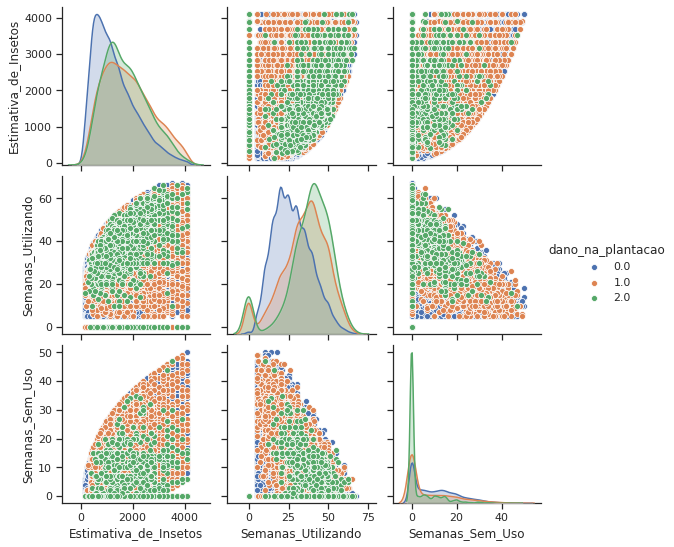

In [10]:
import seaborn as sns
sns.set(style="ticks")

sns.pairplot(df[quantitative + [label]], hue=label);

By separating our label by color, we can see here that there is no easy separation of the classes just by looking at two features at a time.

## Categorical and Quantitative Grouping

In [11]:

fig = px.imshow(df.corr(method =  'spearman').abs())
fig.update_xaxes(side="top")
fig.show()


In [12]:

import plotly.express as px
for c in categorical:
    for q in quantitative:
        fig = px.box(df.dropna(), x=c, y=q, color=label)
        fig.show()
        

We can notice here that the label `1` and `2` are very simmilar for most of the grouping done. Let's try to combine those two and see if we can find any paterns.

In [13]:
df['dano_na_plantacao_binario'] = df[label].map({0:0,1:1,2:1})

In [14]:

fig = px.scatter(df, x="Semanas_Sem_Uso", y="Semanas_Utilizando", color="dano_na_plantacao_binario", opacity=0.8 )
fig.update(layout_coloraxis_showscale=False)
fig.show()


fig = px.scatter(df[df['dano_na_plantacao_binario'] == 1], x="Semanas_Sem_Uso", y="Semanas_Utilizando")
fig.show()

In [15]:
df[df['Tipo_de_Cultivo'] == 1].groupby(label).mean()

,Estimativa_de_Insetos,Tipo_de_Cultivo,Tipo_de_Solo,Categoria_Pesticida,Doses_Semana,Semanas_Utilizando,Semanas_Sem_Uso,Temporada,dano_na_plantacao_binario
dano_na_plantacao,,,,,,,,,
0.0,1218.511538,1.0,0.213878,2.421305,21.488297,26.905136,6.412207,1.900505,0
1.0,1633.192933,1.0,0.354459,2.628716,18.839035,32.844644,2.380258,1.885586,1
2.0,1561.723785,1.0,0.427110,2.601023,21.470588,32.984655,0.820972,1.884910,1


# Clustering 

Now we can try our higher dimensions clustering and see if we get any segregation of the labels

In [16]:

x = df[quantitative].values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
dfnorm = pd.DataFrame(x_scaled, columns = quantitative)
    

Let's try different numbers of clusters and use the elbow method to find the optimal number. To determine the optimal number of clusters, we have to select the value of k at the “elbow” ie the point after which the distortion/inertia start decreasing in a linear fashion. 

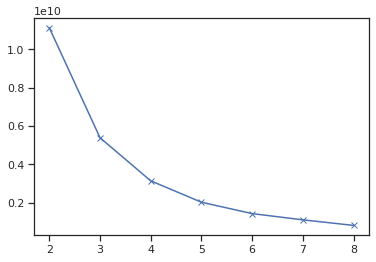

In [17]:
import matplotlib.pyplot as plt

cluster_cols = ['Semanas_Sem_Uso', 'Tipo_de_Solo', 'Estimativa_de_Insetos']
inertias = [] 
clusters =  [2,3,4,5,6,7,8]
for n_clusters in clusters:
    clusterer = KMeans(n_clusters=n_clusters)
    clabels = clusterer.fit_predict(df[cluster_cols])
    inertias.append(clusterer.inertia_)

plt.plot(clusters, inertias, 'bx-')
plt.show()

In this case, it looks like the optimal value is k = 4. Let's look at the clusters and see if there is any segregation done by the unsupervised algorithm.

In [18]:
clusterer = KMeans(n_clusters= 4 )
df['Cluster'] = clusterer.fit_predict(df[cluster_cols])

In [19]:
df.groupby(['Cluster', label]).count().iloc[:,[0]]

Identificador_Agricultor
Cluster dano_na_plantacao                          
0       0.0                                    9066
        1.0                                    2274
        2.0                                     445
1       0.0                                   15442
        1.0                                    1192
        2.0                                     205
2       0.0                                    3487
        1.0                                    1522
        2.0                                     221
3       0.0                                   13891
        1.0                                    2101
        2.0                                     464

In [20]:
df.groupby(['Cluster', 'dano_na_plantacao_binario']).count().iloc[:,[0]]

Identificador_Agricultor
Cluster dano_na_plantacao_binario                          
0       0                                              9066
        1                                              2719
1       0                                             15442
        1                                              1397
2       0                                              3487
        1                                              1743
3       0                                             13891
        1                                              2565

Even after trying to clusters into subgroups by features, there is no significant segregation of the labels. It seems like unsupervised learning won't help us here. 